# Training a Foreground Segmentation Tool with DINOv3

In this tutorial, we will train a linear foreground segmentation model using DINOv3 features.

### Setup

Let's start by loading some pre-requisites and checking the DINOv3 repository location:
- `local` if `DINOV3_LOCATION` environment variable was set to work with a local version of DINOv3 repository;
- `github` if the code should be loaded via torch hub.

# Sette opp virtuel miljø 

## Hvis du har allerede en venv
- En mappe med navnet ".venv"(eller en annet navn som du selv har spesifisert) finnes i mappen din.
- Aktivere miljøet: 
    - CTRL + SHIFT + P 
    - Skriv følgende i feltet øverst på midten ">Python: Select Interpreter"
    - Velg det virtuelle miljøet som finnes. Står som oftest: Python 3.x.x (.venv) ...
- Lage ny venv
    - CTRL + SHIFT + P 
    - Skriv følgende i feltet øverst på midten ">Python: Select Interpreter"
    - Trykk "+ Create Virtual Environment"
    - Trykk deg videre og videre 


# Clone DINOv3

Clonet repoet til en valgfri mappe. 

- Repo: [https://github.com/facebookresearch/dinov3](https://github.com/facebookresearch/dinov3)


In [20]:
import os

# Sette miljøvariabler for DINOv3
# Dette bruker vi nedenfor for å finne nedlastede repoet: Du må skrive din egen sti her
os.environ["DINOV3_LOCATION"] = r"C:\ml\dinov3"


In [21]:
# Sjekke om miljøvariabelen er satt riktig

print("DINOV3_LOCATION:", os.getenv("DINOV3_LOCATION"))

DINOV3_LOCATION: C:\ml\dinov3


In [22]:
# Laste ned alle pakkene som trengs: 
%pip install torch torchvision pillow numpy matplotlib scipy scikit-learn tqdm

# Eller kan man laste ned fra terminalen med "pip install -r requirements.txt" 

Note: you may need to restart the kernel to use updated packages.


In [23]:
#importere nødvendige biblioteker

import io
import os
import pickle
import tarfile
import urllib

from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.linear_model import LogisticRegression
import torch
import torchvision.transforms.functional as TF
from tqdm import tqdm

# Kommentere ut denne delen som setter DINOv3_LOCATION

# DINOV3_GITHUB_LOCATION = "facebookresearch/dinov3"

# if os.getenv("DINOV3_LOCATION") is not None:
#     DINOV3_LOCATION = os.getenv("DINOV3_LOCATION")
# else:
#     DINOV3_LOCATION = DINOV3_GITHUB_LOCATION

# print(f"DINOv3 location set to {DINOV3_LOCATION}")


In [24]:
# sett DINOv3 location til miljøvariabelen
DINOV3_LOCATION = r"C:\ml\dinov3"

os.environ["DINOV3_LOCATION"] = DINOV3_LOCATION

if not os.path.exists(DINOV3_LOCATION):
    raise ValueError(f"DINOv3-mappen finnes ikke på: {DINOV3_LOCATION}")

print("✅ DINOv3 location set to:", DINOV3_LOCATION)


✅ DINOv3 location set to: C:\ml\dinov3


### Model

Let's load the DINOv3 model. For this notebook, we will be using the ViT-L model, but if you have more or less hardware constraints, you can easily load any other DINOv3 model!

Du kan lese mere om modellen på [https://github.com/facebookresearch/dinov3](https://github.com/facebookresearch/dinov3).


# Laste ned "Weights" før vi laster inn modellen vi ønsker

- Gå til denne seksjonen på github: [https://github.com/facebookresearch/dinov3?tab=readme-ov-file#pretrained-models](https://github.com/facebookresearch/dinov3?tab=readme-ov-file#pretrained-models)
- Trykk på først modellen
- Fyll inn skjema informasjon, du får epost med link for å laste ned modellene
- Du trenger kun å laste ned denne modellen fra eposten: dinov3_vits16
- Lagre den et sted som du kan finne etterpå

# Vi laster inn modellen med koden nedenfor

**Trinn-for-trinn prosess:**

1. **Første kjøring (forventer feil):**
   - Koden nedenfor krever at vi har lagret "Weights" filen i: `~/.cache/torch/hub/checkpoints/`
   - Men denne mappen eksisterer ikke hvis vi ikke har lastet inn modeller med torch før
   - Vi kjører koden en gang - den vil feile fordi den ikke finner "Weights" enda, men den lager alle mappene

2. **Flytt weights-filen til riktig sted:**
   - Nå er mappene klare, du kan sjekke selv på `~/.cache/torch/hub/checkpoints/` (~ = Home/bruker_navn)
   - Flytt "weights" filen du lastet ned til `~/.cache/torch/hub/checkpoints/`

3. **Andre kjøring (skal fungere):**
   - Kjør koden på nytt, den vil laste inn modellen riktig denne gangen

In [26]:

# Vi starer med denne, da denne er minst og krever mindre ressurser
MODEL_DINOV3_VITS = "dinov3_vits16"

# Andre modeller du kan prøve
# Husk at du må laste ned "weights" for den modellen du ønsker å bruke
MODEL_DINOV3_VITSP = "dinov3_vits16plus"
MODEL_DINOV3_VITB = "dinov3_vitb16"
MODEL_DINOV3_VITL = "dinov3_vitl16"
MODEL_DINOV3_VITHP = "dinov3_vith16plus"
MODEL_DINOV3_VIT7B = "dinov3_vit7b16"

# we take DINOv3 ViT-S (since we have the pretrained weights for this model)
MODEL_NAME = MODEL_DINOV3_VITS # Her kan du velge en annen modell 
# Endre denne linjen til din lokale mappe:
DINOV3_LOCATION = r"C:\ml\dinov3"

# Legg til én linje som peker til vekta vi lastet ned:
import pathlib
WEIGHTS_PATH = pathlib.Path.home() / ".cache" / "torch" / "hub" / "checkpoints" / "dinov3_vits16_pretrain_lvd1689m-08c60483.pth"

# Load model without pretrained weights to avoid web download
model = torch.hub.load(
    repo_or_dir=DINOV3_LOCATION,
    model=MODEL_NAME,
    source="local",
    pretrained=True 
)

# Set model to evaluation mode and move to GPU
model.eval()
device = "cuda" if torch.cuda.is_available() else "cpu"  # blir "cpu" hos deg
model.to(device)

dummy_input = torch.randn(1, 3, 224, 224, device=device)

with torch.no_grad():
    try:
        test_output = model(dummy_input)
        print(f"Model test successful. Output shape: {test_output.shape}")
        print(f"Output has NaN: {torch.isnan(test_output).any()}")
        print(f"Output range: {test_output.min():.4f} to {test_output.max():.4f}")
    except Exception as e:
        print(f"Model test failed: {e}")
        print("There might be an issue with the model or checkpoint loading.")

Model test successful. Output shape: torch.Size([1, 384])
Output has NaN: False
Output range: -1.8280 to 1.5620


### Data

- Vi laster inn bildene lokalt fra data mappen

**Orginale bilder:**
- images in `jpg` format:
```
https://dl.fbaipublicfiles.com/dinov3/notebooks/foreground_segmentation/foreground_segmentation_images.tar.gz
```
- and segmentation masks stored as alpha channels in `png` files:
```
https://dl.fbaipublicfiles.com/dinov3/notebooks/foreground_segmentation/foreground_segmentation_labels.tar.gz
```

In total, there are 9 training image / mask pairs.


In [32]:
import os, shutil, pathlib
from PIL import Image, UnidentifiedImageError, ImageFile

# gjør PIL mer tolerant for delvise filer
ImageFile.LOAD_TRUNCATED_IMAGES = True

# prøv å aktivere HEIC-støtte (trygt om pakken ikke finnes)
try:
    from pillow_heif import register_heif_opener
    register_heif_opener()
    print("HEIF/HEIC support enabled.")
except Exception as e:
    print("HEIF/HEIC support not enabled (ok hvis du ikke har HEIC):", e)

# --- STIER ---
image_folder = r"C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images"
label_folder = r"C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\labels"
converted_folder = r"C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted"

os.makedirs(converted_folder, exist_ok=True)

def header_hex(path, n=12):
    try:
        with open(path, "rb") as f:
            return f.read(n).hex()
    except Exception:
        return None

def convert_if_needed(src_path, dst_path):
    """
    Åpner et bilde (inkl. HEIC hvis pillow-heif er aktivert) og lagrer som ekte PNG.
    Returnerer True hvis konvertering lykkes.
    """
    try:
        img = Image.open(src_path)
        img.convert("RGB").save(dst_path)
        return True
    except Exception:
        return False

def prepare_images_folder(src_folder, dst_folder):
    """
    Går gjennom images/, konverterer alt PIL ikke kjenner igjen til ekte .png i images_converted/.
    Hvis filen fra før er gyldig PNG/JPG, kopieres den bare over.
    Til slutt returnerer vi mappen som skal brukes videre (dst_folder).
    """
    converted = 0
    copied = 0
    skipped = 0

    # tøm evt. gamle konverteringer for å unngå miks
    for f in os.listdir(dst_folder):
        try:
            os.remove(os.path.join(dst_folder, f))
        except Exception:
            pass

    for fname in sorted(os.listdir(src_folder)):
        if not fname.lower().endswith(('.png', '.jpg', '.jpeg', '.heic', '.heif')):
            continue

        src = os.path.join(src_folder, fname)
        # bestem utfilnavn (png)
        stem = os.path.splitext(fname)[0]
        dst = os.path.join(dst_folder, f"{stem}.png")

        # prøv å åpne direkte; hvis det feiler, konverter
        try:
            img = Image.open(src)
            img.verify()  # rask sjekk på at filen faktisk er gyldig
            # last på nytt for å bruke objektet etter verify()
            img = Image.open(src).convert("RGB")
            img.save(dst)
            copied += 1
        except Exception:
            # prøv konvertering (HEIC/feilendelse/annet)
            sig = header_hex(src)
            ok = convert_if_needed(src, dst)
            if ok:
                print(f"Converted -> {os.path.basename(dst)}  (header: {sig})")
                converted += 1
            else:
                print(f"SKIPPING (cannot read/convert): {fname}  (header: {sig})")
                skipped += 1

    print(f"\nPrepare summary: copied={copied}, converted={converted}, skipped={skipped}")
    if copied + converted == 0:
        raise RuntimeError("Ingen bilder kunne åpnes/konverteres. Sjekk at filene er lokale og faktisk er bilder.")
    return dst_folder

# Forbered ekte PNG-er i images_converted/
use_image_folder = prepare_images_folder(image_folder, converted_folder)

# --------- LASTER BILDER OG MASKER (minst mulig endring fra original) ----------
def load_images_from_folder(folder: str):
    images = []
    skipped = 0
    for filename in sorted(os.listdir(folder)):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            path = os.path.join(folder, filename)
            try:
                img = Image.open(path)
                images.append(img)
                print(f"Loaded {filename} from {folder}")
            except UnidentifiedImageError:
                print(f"SKIPPING (cannot identify): {filename}")
                skipped += 1
            except FileNotFoundError:
                print(f"SKIPPING (not local / placeholder): {filename}")
                skipped += 1
    print(f"Total images loaded from {folder}: {len(images)} (skipped: {skipped})\n")
    return images

# bruk konvertert mappe for images
images = load_images_from_folder(use_image_folder)
labels = load_images_from_folder(label_folder)

n_images = len(images)
assert n_images == len(labels), f"{len(images)=}, {len(labels)=}"
print(f"✅ Loaded {n_images} images and labels (using: {use_image_folder})")




HEIF/HEIC support enabled.

Prepare summary: copied=13, converted=0, skipped=0
Loaded IMG_4494.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4495.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4496.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4500.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4501.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4505.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4510.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4514.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4515.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Data\images_converted
Loaded IMG_4520.png from C:\Users\Ahmad\OneDrive\Skrivebord\Segmen

Let's, for example, visualize the first image / mask pair:

C:\Users\Ahmad\AppData\Local\Temp\ipykernel_22692\2059886453.py:18: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  mask_bg    = Image.fromarray(mask_bg_np, mode="L")


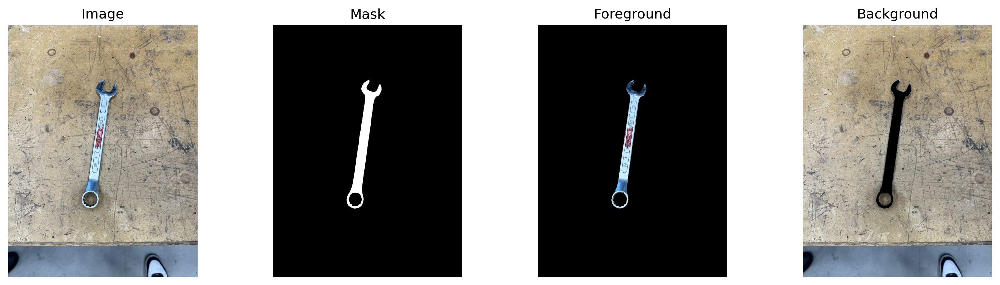

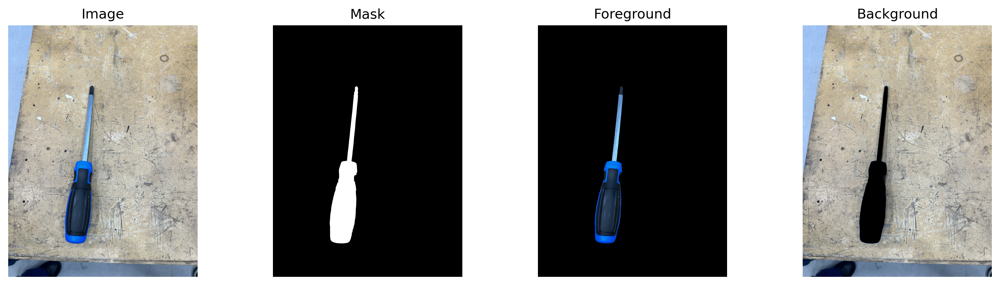

In [36]:

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt  # <-- MÅ med for å vise bilder i notebook

def show_images(amount):
    for image, mask in zip(images[:amount], labels[:amount]):
        # Riktig modus
        image = image.convert("RGB")
        mask  = mask.convert("L")  # gråtone

        # Forgrunn: behold der masken er hvit
        black = Image.new("RGB", image.size, (0, 0, 0))
        foreground = Image.composite(image, black, mask)

        # Bakgrunn: inverter masken
        mask_np    = np.array(mask, dtype=np.uint8)   # (H, W)
        mask_bg_np = 255 - mask_np
        mask_bg    = Image.fromarray(mask_bg_np, mode="L")
        background = Image.composite(image, black, mask_bg)

        data_to_show  = [image, mask, foreground, background]
        data_labels   = ["Image", "Mask", "Foreground", "Background"]

        plt.figure(figsize=(16, 4), dpi=300)
        for i in range(len(data_to_show)):
            plt.subplot(1, len(data_to_show), i + 1)
            if i == 1:   # masken
                plt.imshow(data_to_show[i], cmap="gray")
            else:
                plt.imshow(data_to_show[i])
            plt.axis("off")
            plt.title(data_labels[i], fontsize=12)
        plt.show()

# KALL FUNKSJONEN:
vise_antall_bilder = 2   # vis 2 par
show_images(vise_antall_bilder)


# Oppgave

Oppgavene ligger i [./oppgaver.ipynb](./oppgaver.ipynb)

---

# Vision Transformer (ViT)

- **Patch + position Embeddings**: Bildet deles opp i små patches som gjøres om til vektorer (embeddings). Posisjonskoder legges til for å bevare hvor i bildet patchene hører hjemme.  

- **Transformer Encoder**: En sekvensmodell som bruker self-attention til å finne sammenhenger mellom alle patches og bygger opp en helhetsforståelse av bildet.  

- **MLP (Multi-Layer Perceptron)**: Et lite nevralt nettverk som oversetter de bearbeidede representasjonene til en mer kompakt form som kan brukes til klassifisering.  

- **Class**: Et eget token ([CLS]) brukes til å samle informasjon fra hele bildet. Denne sendes videre til en klassifikator som kan trenes på brukerdefinerte kategorier eller merker.  


![image.png](https://raw.githubusercontent.com/RobvanGastel/dinov3-finetune/d109d85a45ab9c03de369f65db5bbd3da5cb77c7/assets/examples/vit.png)

### Building Per-Patch Label Map

Since our models run with a patch size of 16, we have to quantize the ground truth to a 16x16 pixels grid. To achieve this, we define:
- the resize transform to resize an image such that it aligns well with the 16x16 grid;
- a uniform 16x16 conv layer as a [box blur filter](https://en.wikipedia.org/wiki/Box_blur) with stride equal to the patch size.

### Patch-basert prosessering i Vision Transformers
**Hvorfor trenger vi denne koden?**

Vision Transformers (ViT) deler bilder inn i 16×16 piksler store "patches" (firkanter). Men våre treningsbilder og masker kan ha hvilken som helst størrelse. Vi må derfor:

- Endre størrelse på bildene så de passer med 16×16 rutenett
- Kvantisere maskene til samme rutenett

In [37]:
# Konstanter for patch-størrelse og bilde-størrelse

PATCH_SIZE = 16    # Hver patch er 16×16 piksler
IMAGE_SIZE = 768   # Standard høyde vi skalerer til (768÷16 = 48 patches høyt)

**Hvorfor 768?**
- 768 ÷ 16 = 48 patches
- Vanlig størrelse for ViT modeller
- Balanse mellom kvalitet og hastighet

### Kvantiseringsfilter
**Hva gjør dette?**

Dette lager et **gjennomsnittsfilter** som:

- Tar gjennomsnittet av alle piksler i hver 16×16 patch
- Reduserer oppløsningen fra piksel-nivå til patch-nivå

In [38]:
patch_quant_filter = torch.nn.Conv2d(1, 1, PATCH_SIZE, stride=PATCH_SIZE, bias=False)
patch_quant_filter.weight.data.fill_(1.0 / (PATCH_SIZE * PATCH_SIZE)) # Fyller data med 1/(16*16)= 0.00390625


tensor([[[[0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039,
           0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039],
          [0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039,
           0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039],
          [0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039,
           0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039],
          [0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039,
           0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039],
          [0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039,
           0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039],
          [0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039,
           0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039],
          [0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039, 0.0039,
           0.0039, 

### Resize Transform

**Hvorfor er dette viktig?**

Før prosessering:
- Bildet kan være 1200×800, 1920×1080, eller hvilken som helst størrelse
- Kan ikke brukes direkte med ViT (krever patch-struktur)

Etter prosessering:
- Bildet er eksakt delelig med 16×16 patches
-  Masken har samme oppløsning som ViT's feature maps
-  Hver patch har en label (forgrunn/bakgrunn)

In [39]:
# Denne funksjonen bruker vi videre for å endre størrelse på maskene slik at de passer med patch-størrelsen
def resize_transform(mask_image: Image, image_size: int = IMAGE_SIZE, patch_size: int = PATCH_SIZE) -> torch.Tensor:
    w, h = mask_image.size                              # Original størrelse
    h_patches = int(image_size / patch_size)            # Antall patches vertikalt (768÷16=48)
    w_patches = int((w * image_size) / (h * patch_size)) # Antall patches horisontalt
    return TF.to_tensor(TF.resize(mask_image, (h_patches * patch_size, w_patches * patch_size)))

Let's, for example, visualize the first mask before and after quantization:

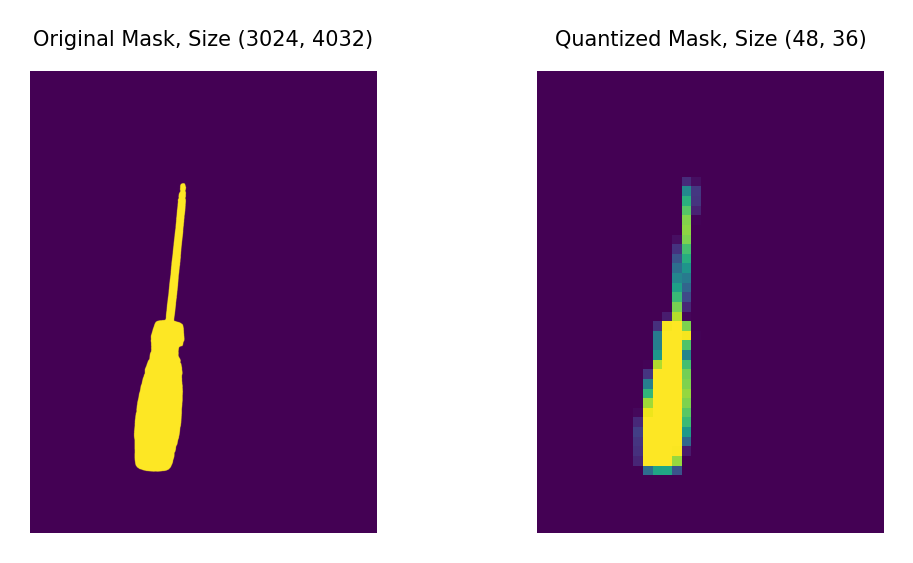

In [40]:
# Her henter vi en maske og viser original og kvantisert maske
# Vi splitter masken i ulike kanaler (RGBA) og bruker bare alpha-kanalen som er siste kanal
mask_0 = labels[1].split()[-1] 
mask_0_resized = resize_transform(mask_0)

with torch.no_grad():
    mask_0_quantized = patch_quant_filter(mask_0_resized).squeeze().detach().cpu()

plt.figure(figsize=(4, 2), dpi=300)
plt.subplot(1, 2, 1)
plt.imshow(mask_0)
plt.axis('off')
plt.title(f"Original Mask, Size {mask_0.size}", fontsize=5)
plt.subplot(1, 2, 2)
plt.imshow(mask_0_quantized)
plt.axis('off')
plt.title(f"Quantized Mask, Size {tuple(mask_0_quantized.shape)}", fontsize=5)
plt.show()

## Patch Grid Visualisering

Nedenfor illustrerer hvordan et bilde ser ut etter kvantifisering.

### **Hva den gjør:**
- **Viser original maske** som gråtonebilde
- **Tegner røde ruter** for hver 16×16 patch 
- **Skriver forgrunn-andel** i hver patch (hviser kun hvis > 0)
- **Formatter tall** for bedre lesbarhet (.5 i stedet for 0.5)

### **Visuelt resultat:**
```
┌─────┬─────┬─────┐
│  .2 │  .8 │     │  ← Patch-verdier
├─────┼─────┼─────┤     (.2 = 20% forgrunn)
│  1  │  .9 │  .1 │
├─────┼─────┼─────┤
│     │  .7 │     │
└─────┴─────┴─────┘
```


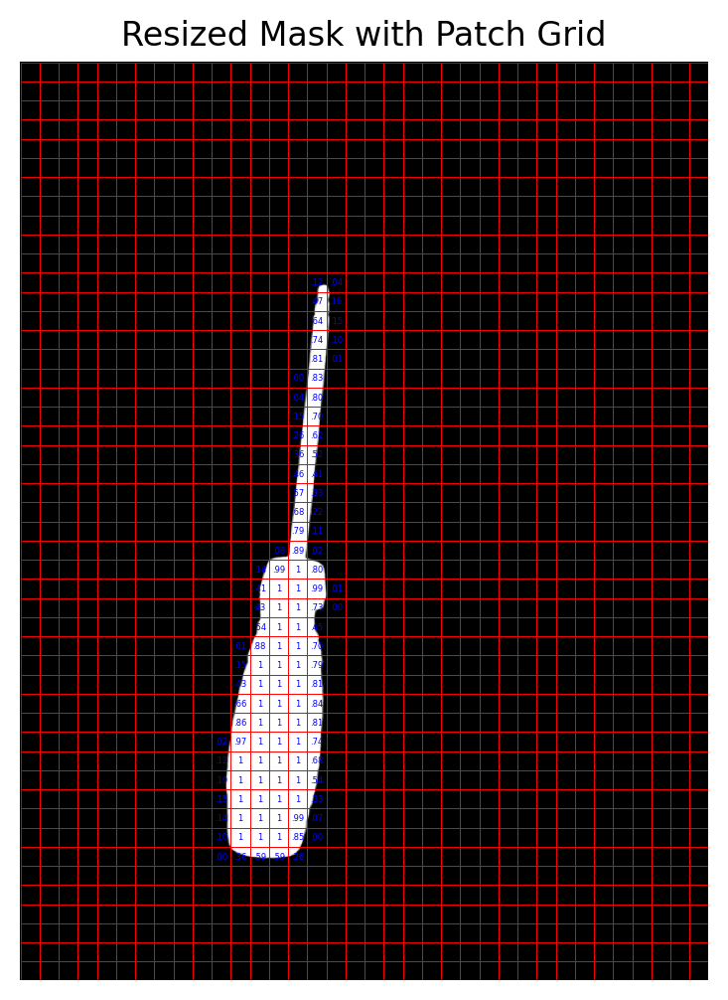

In [41]:
import matplotlib.patches as patches

# Plot with grid overlay
plt.figure(figsize=(6, 6), dpi=200)
plt.imshow(mask_0_resized.squeeze().numpy(), cmap="gray")
plt.axis("off")
plt.title("Resized Mask with Patch Grid")

h, w = mask_0_resized.shape[1:]
for y in range(0, h, PATCH_SIZE):
    for x in range(0, w, PATCH_SIZE):
        rect = patches.Rectangle((x, y), PATCH_SIZE, PATCH_SIZE,
                                 linewidth=0.3, edgecolor="red", facecolor="none")

        # Prosentandel av "foreground" i denne patchen        
        foreground_present = mask_0_quantized[y // PATCH_SIZE, x // PATCH_SIZE]

        # Vise bare tekst hvis det er noe "foreground" i patchen
        if foreground_present != 0:
            rect_text = f"{foreground_present:.2f}" # Tar med to desimaler
            
            # Formatere teksten for å unngå store tall som 0.07 eller 1.00 etc.
            # Splitter teksten ved desimalpunktet, vi får tilbake en liste med to elementer for eksempel 0.07 --> ["0", "07"]
            rect_text_split = rect_text.split(".")
            if rect_text_split[0] == "0":
                rect_text = f".{rect_text_split[1]}"
            elif rect_text_split[0] == "1":
                rect_text = f"{rect_text_split[0]}"
            else:
                rect_text = f"{rect_text_split[0]}.{rect_text_split[1]}"

            plt.text(x + PATCH_SIZE / 2, y + PATCH_SIZE / 2, rect_text,
                    color="blue", fontsize=3, ha="center", va="center")
        plt.gca().add_patch(rect)


plt.show()

### Extracting Features and Labels for All the Images
Now we will loop over the 9 training images, and extract for each image the patch labels, as well as the patch features. That involves running the dense feature extraction of our model with :

```
with torch.no_grad():        
    feats = model.get_intermediate_layers(img, n=range(n_layers), reshape=True, norm=True)
    dim = feats[-1].shape[1]
    xs.append(feats[-1].squeeze().view(dim, -1).permute(1,0).detach().cpu())
```

- xs -> Liste over "features"
- ys -> liste over "labels" (foreground = 1, bakground = 0, per patch)
- image_index -> holder orden hvilket del av bilde en patch tilhører. 
    - Når vi deler opp bilde i patcher (de røde rectanglene i forige bilde)
    - Hvert patch (rectangel) får en indeks for å holde orden på hvor på bilde en batch tilhører

In [42]:
# Vi kan printe litt informasjon om modellen
print(model)

DinoVisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 384, kernel_size=(16, 16), stride=(16, 16))
    (norm): Identity()
  )
  (rope_embed): RopePositionEmbedding()
  (blocks): ModuleList(
    (0-11): 12 x SelfAttentionBlock(
      (norm1): LayerNorm((384,), eps=1e-05, elementwise_affine=True)
      (attn): SelfAttention(
        (qkv): LinearKMaskedBias(in_features=384, out_features=1152, bias=True)
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=384, out_features=384, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): LayerScale()
      (norm2): LayerNorm((384,), eps=1e-05, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=384, out_features=1536, bias=True)
        (act): GELU(approximate='none')
        (fc2): Linear(in_features=1536, out_features=384, bias=True)
        (drop): Dropout(p=0.0, inplace=False)
      )
      (ls2): LayerScale()
    )
  )
  (norm): LayerN

Processing images:   0%|          | 0/13 [00:00<?, ?it/s]

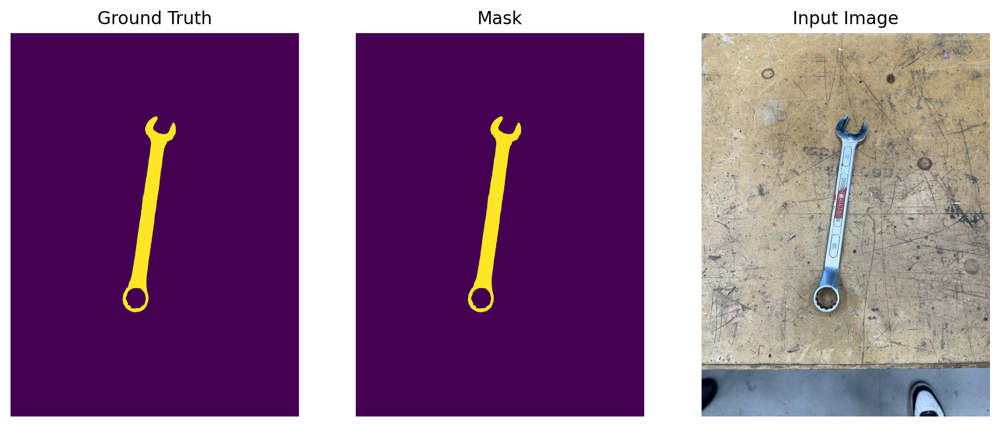

Processing images:   8%|▊         | 1/13 [00:04<00:53,  4.46s/it]

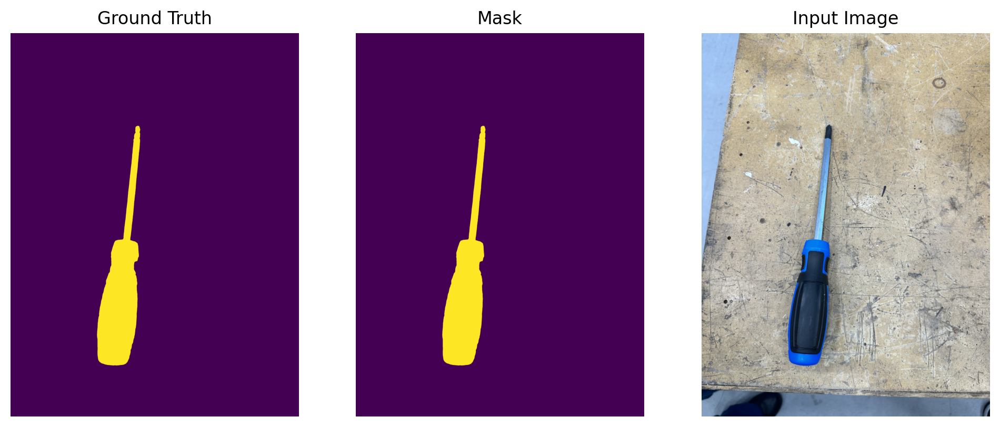

Processing images:  15%|█▌        | 2/13 [00:09<00:50,  4.58s/it]

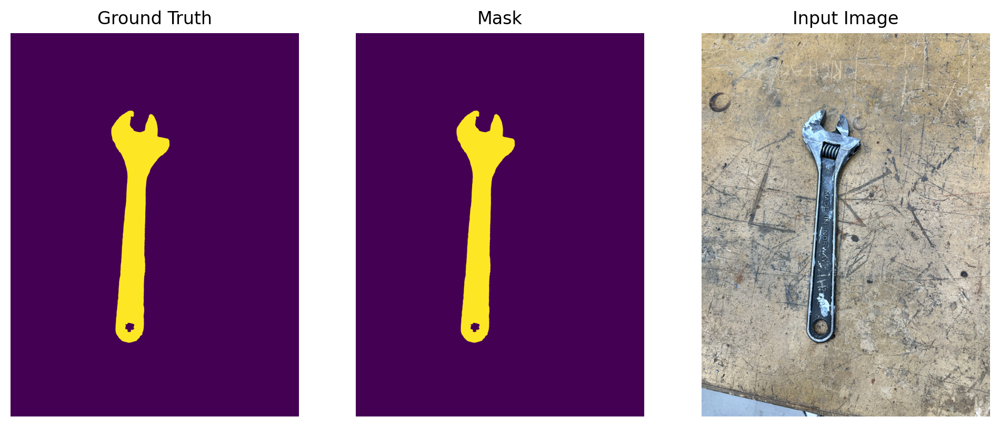

Processing images:  23%|██▎       | 3/13 [00:13<00:46,  4.61s/it]

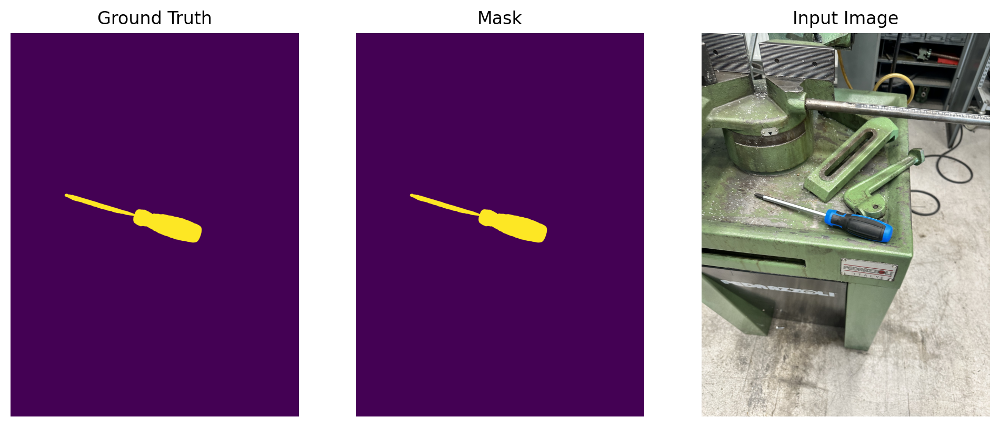

Processing images:  31%|███       | 4/13 [00:18<00:41,  4.61s/it]

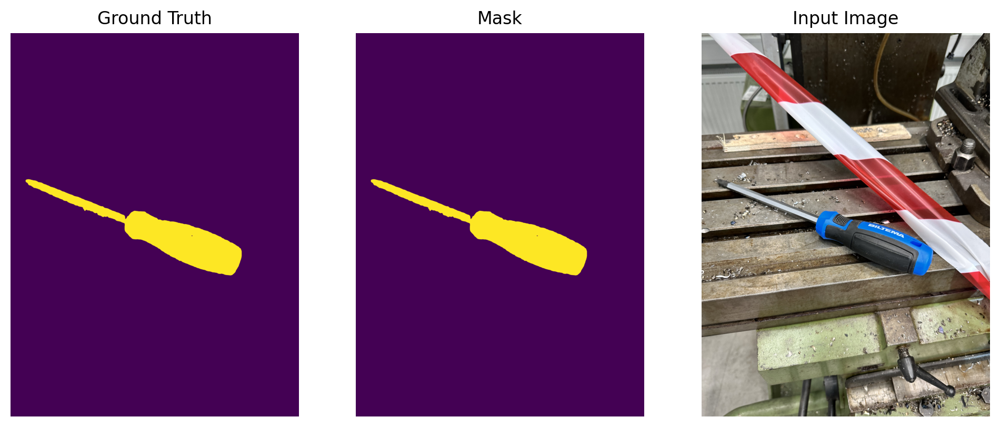

Processing images:  38%|███▊      | 5/13 [00:23<00:36,  4.62s/it]

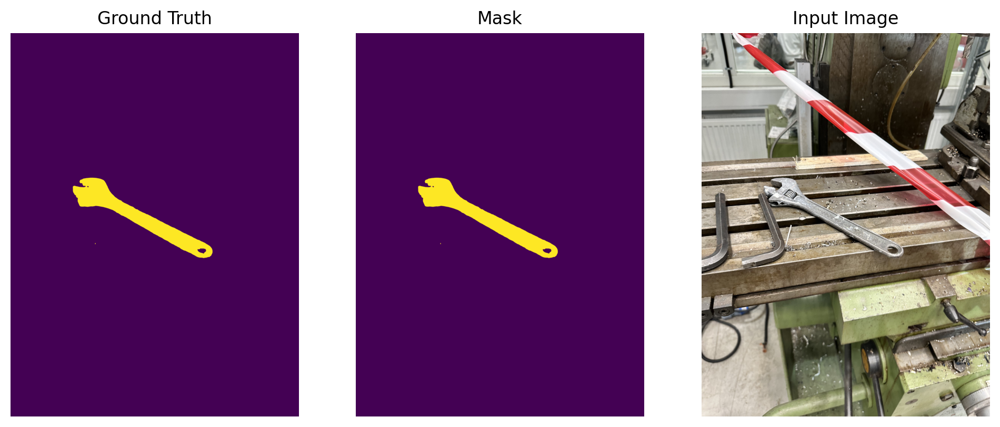

Processing images:  46%|████▌     | 6/13 [00:27<00:32,  4.60s/it]

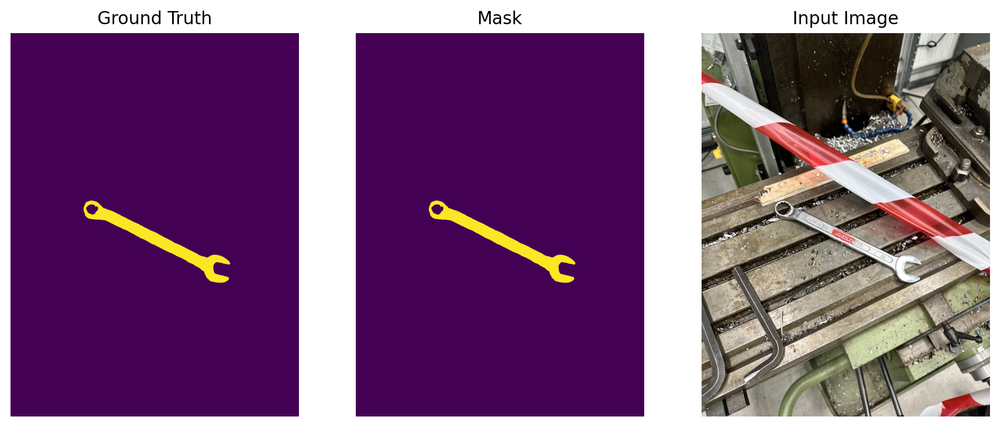

Processing images:  54%|█████▍    | 7/13 [00:32<00:27,  4.58s/it]

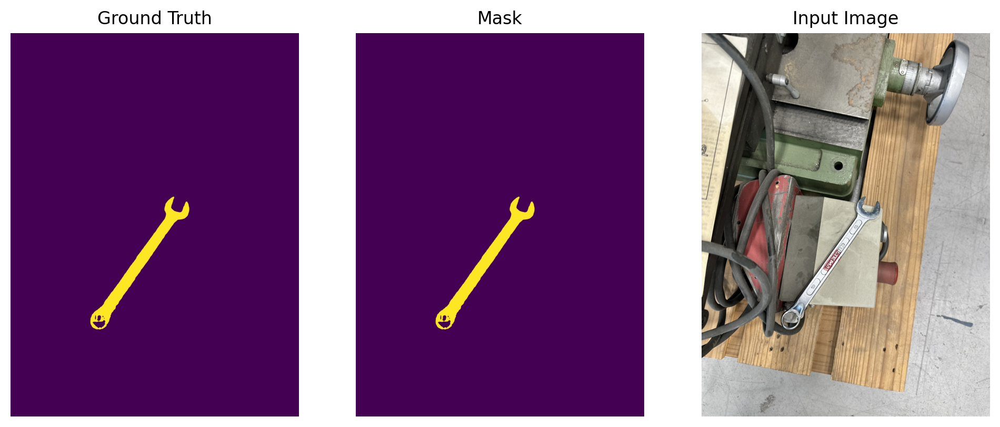

Processing images:  62%|██████▏   | 8/13 [00:36<00:22,  4.59s/it]

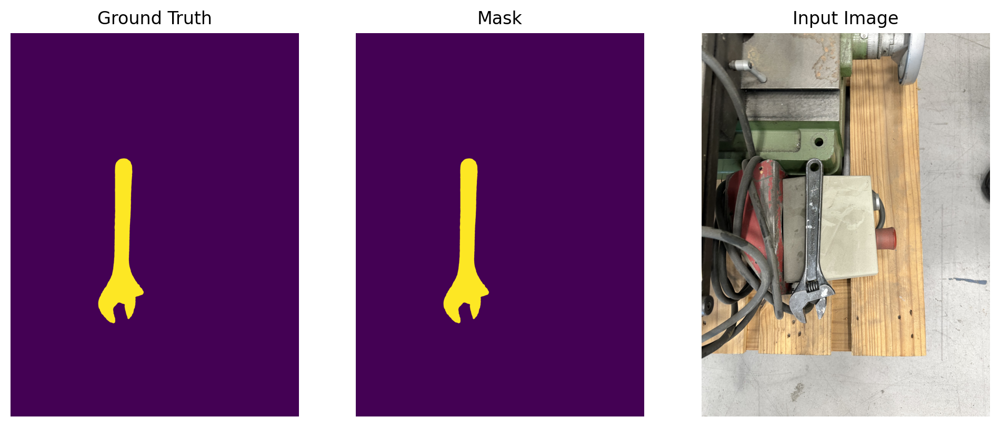

Processing images:  69%|██████▉   | 9/13 [00:41<00:18,  4.63s/it]

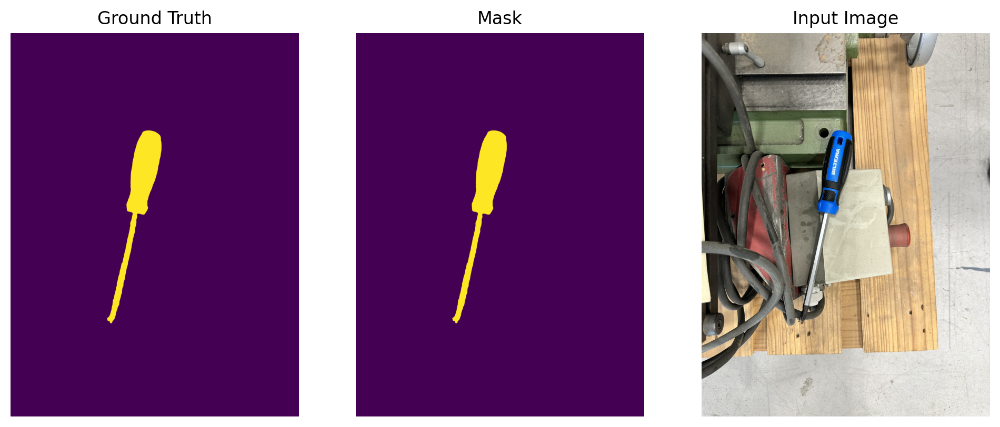

Processing images:  77%|███████▋  | 10/13 [00:46<00:13,  4.63s/it]

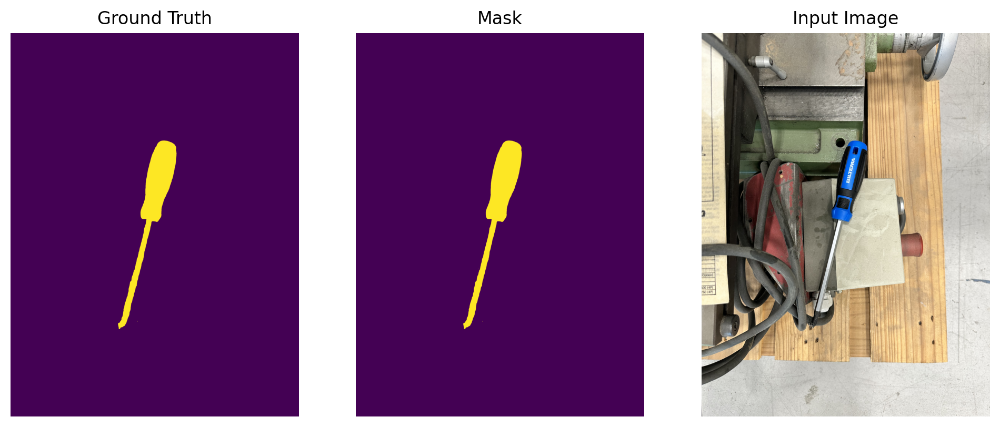

Processing images:  85%|████████▍ | 11/13 [00:50<00:09,  4.65s/it]

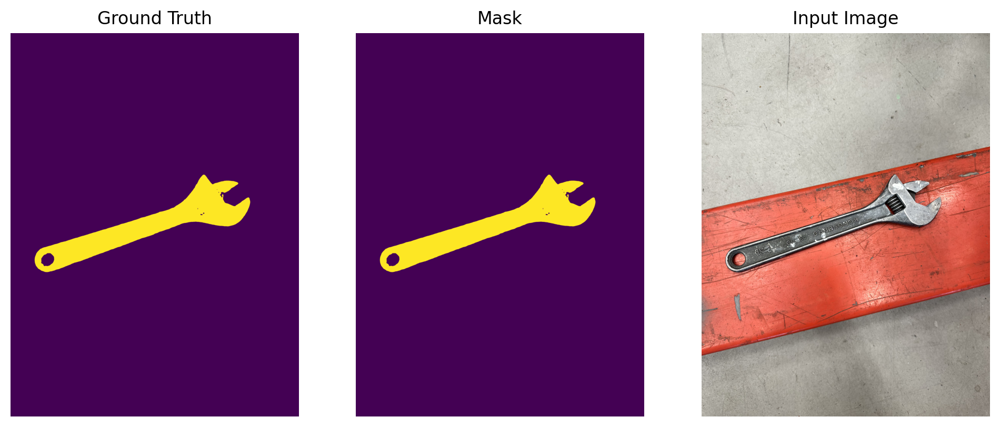

Processing images:  92%|█████████▏| 12/13 [00:55<00:04,  4.71s/it]

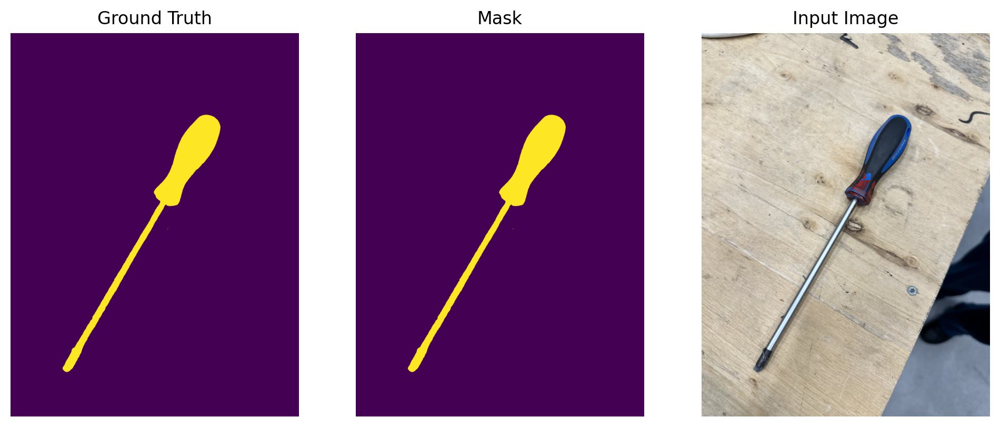

Processing images: 100%|██████████| 13/13 [01:00<00:00,  4.64s/it]

Design matrix: torch.Size([21669, 384])
Labels: torch.Size([21669])


In [44]:
from contextlib import nullcontext

xs = []
ys = []
image_index = []

IMAGENET_MEAN = (0.485, 0.456, 0.406)  # RGB mean for ImageNet
IMAGENET_STD  = (0.229, 0.224, 0.225)  # RGB std for ImageNet

# Self-attention lagene i DINOv3 ViT-modellene
MODEL_TO_NUM_LAYERS = {
    MODEL_DINOV3_VITS: 12,
    MODEL_DINOV3_VITSP: 12,
    MODEL_DINOV3_VITB: 12,
    MODEL_DINOV3_VITL: 24,
    MODEL_DINOV3_VITHP: 32,
    MODEL_DINOV3_VIT7B: 40,
}
n_layers = MODEL_TO_NUM_LAYERS[MODEL_NAME]

# --- NYTT: velg enhet og AMP-kontekst trygt ---
device = "cuda" if torch.cuda.is_available() else "cpu"
amp_ctx = torch.autocast(device_type="cuda", dtype=torch.float16) if device == "cuda" else nullcontext()

with torch.inference_mode():
    with amp_ctx:
        for i in tqdm(range(n_images), desc="Processing images"):

            # ---- ground truth / mask ----
            mask_i = labels[i].split()[-1]                    # alpha-kanal som maske (L)
            mask_i_resized  = resize_transform(mask_i)        # (1, H, W) på CPU
            mask_i_quantized = patch_quant_filter(mask_i_resized).squeeze().view(-1).detach().cpu()
            ys.append(mask_i_quantized)

            # ---- inputbilde ----
            image_i = images[i].convert("RGB")
            image_i_resized = resize_transform(image_i)                              # (3, H, W) tensor
            image_i_resized = TF.normalize(image_i_resized, mean=IMAGENET_MEAN, std=IMAGENET_STD)
            image_i_resized = image_i_resized.unsqueeze(0).to(device)               # <-- .to(device) i stedet for .cuda()

            # ---- features fra alle lag ----
            feats = model.get_intermediate_layers(
                image_i_resized, n=range(n_layers), reshape=True, norm=True
            )

            # Debug (valgfritt)
            # print(f"Feature map count: {len(feats)} | siste: {feats[-1].shape}")
            dim = feats[-1].shape[1]

            # Lag X: (num_patches, dim)
            xs.append(feats[-1].squeeze().view(dim, -1).permute(1, 0).detach().cpu())

            # Hvilket bilde hver patch kom fra
            image_index.append(i * torch.ones(ys[-1].shape, dtype=torch.long))

            # --- (valgfritt) enkel visualisering ---
            plt.figure(figsize=(12, 6), dpi=200)
            plt.subplot(1, 3, 1); plt.imshow(labels[i]); plt.title("Ground Truth"); plt.axis("off")
            plt.subplot(1, 3, 2); plt.imshow(mask_i);    plt.title("Mask");         plt.axis("off")
            plt.subplot(1, 3, 3); plt.imshow(image_i);   plt.title("Input Image");  plt.axis("off")
            plt.show()

# --- concat ---
xs = torch.cat(xs)             # (total_patches, dim)
ys = torch.cat(ys)             # (total_patches,)
image_index = torch.cat(image_index)

# beholde bare klare positive/negative patches
idx = (ys < 0.01) | (ys > 0.99)
xs = xs[idx]
ys = ys[idx]
image_index = image_index[idx]

print("Design matrix:", xs.shape)
print("Labels:", ys.shape)



### Training a Classifier and Model Selection
We computed the features, let's now train a classifier! Our data is very strongly correlated image-by-image. Therefore, to do proper model selection, we can't simply split the data in an IID way. We need to do something a bit smarter. We will do leave-one-out, and consecutively exclude each image as a validation set. 
We'll try 8 values of C ranging from 1e-7 to 1e-0. 

For each value of C and each image, we plot the precision-recall curve of the classifier, and report the mAP (area under the PR curve).

validation using image_01.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


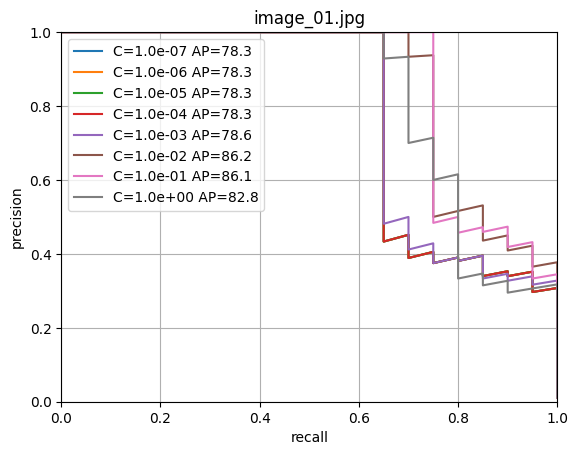

validation using image_02.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


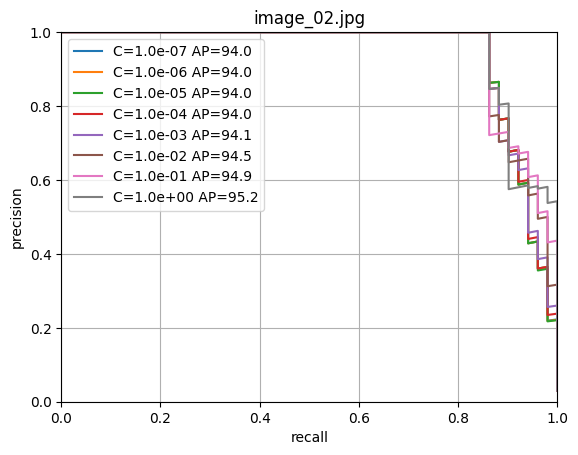

validation using image_03.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


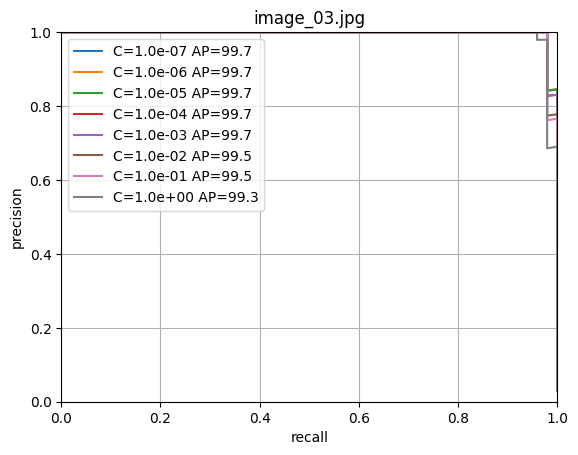

validation using image_04.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


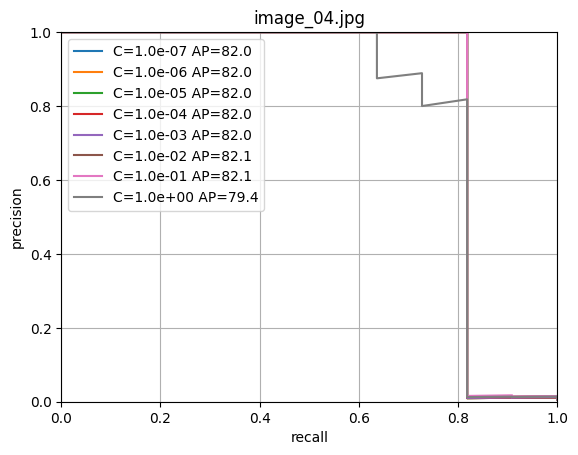

validation using image_05.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


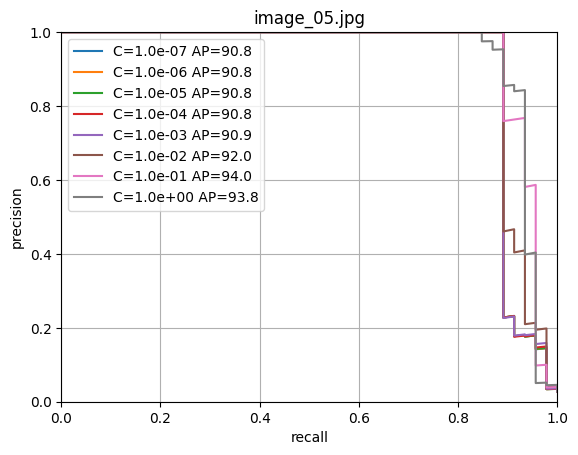

validation using image_06.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


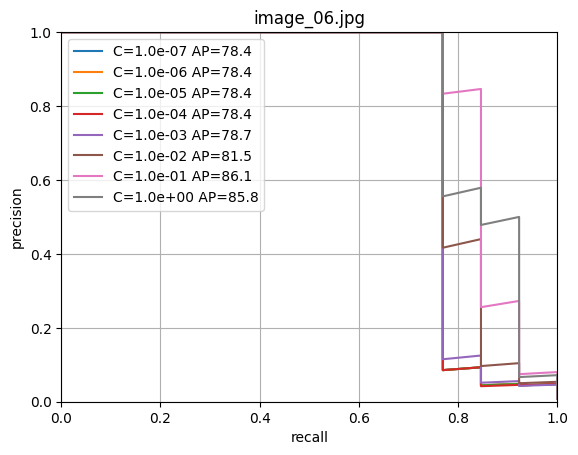

validation using image_07.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


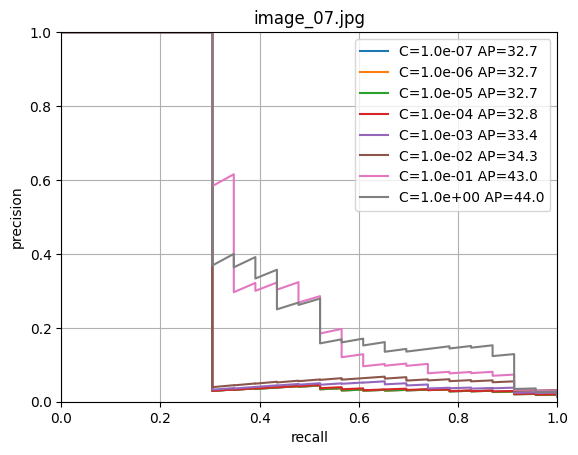

validation using image_08.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


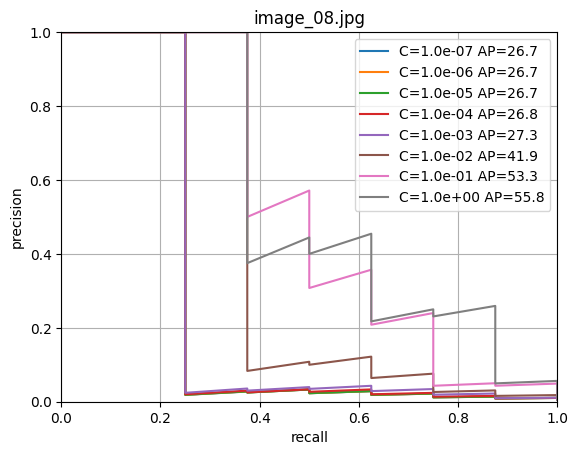

validation using image_09.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


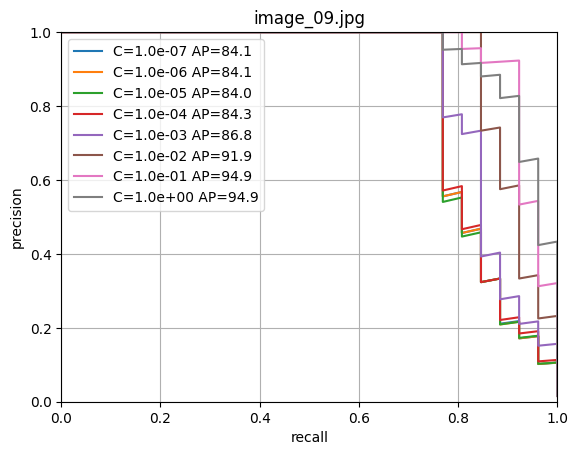

validation using image_10.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


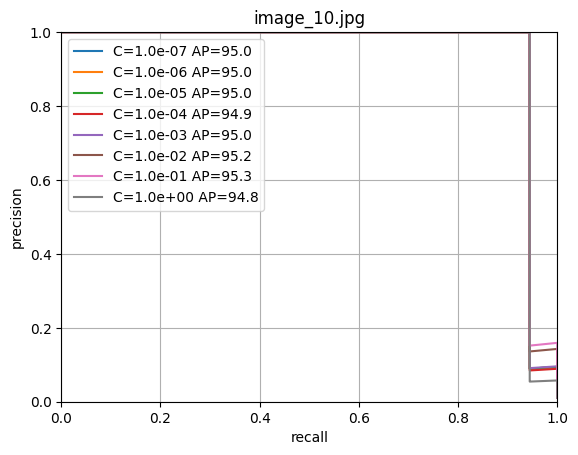

validation using image_11.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


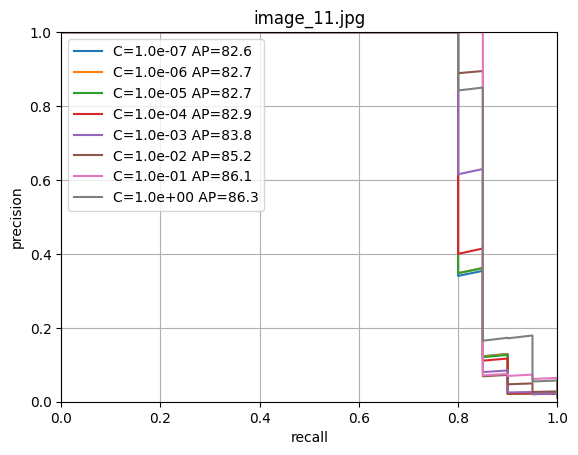

validation using image_12.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


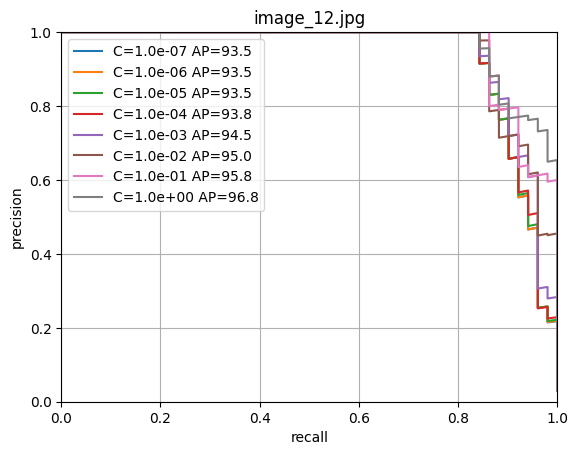

validation using image_13.jpg
training logisitic regression with C=1.00e-07
training logisitic regression with C=1.00e-06
training logisitic regression with C=1.00e-05
training logisitic regression with C=1.00e-04
training logisitic regression with C=1.00e-03
training logisitic regression with C=1.00e-02
training logisitic regression with C=1.00e-01
training logisitic regression with C=1.00e+00


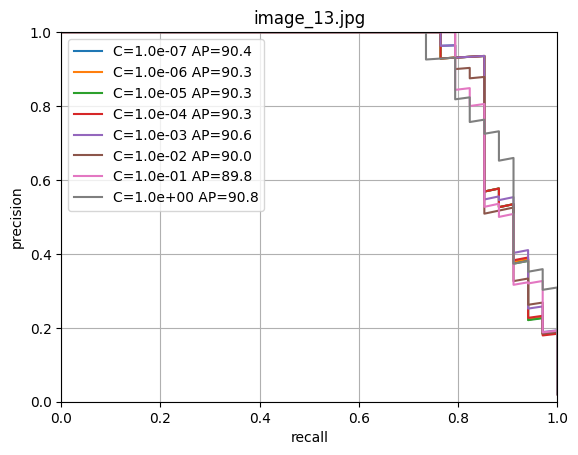

In [45]:
cs = np.logspace(-7, 0, 8)
scores = np.zeros((n_images, len(cs)))

for i in range(n_images):
    # We use leave-one-out so train will be all but image i, val will be image i
    print('validation using image_{:02d}.jpg'.format(i+1))
    train_selection = image_index != float(i)
    fold_x = xs[train_selection].numpy()
    fold_y = (ys[train_selection] > 0).long().numpy()
    val_x = xs[~train_selection].numpy()
    val_y = (ys[~train_selection] > 0).long().numpy()

    plt.figure()
    for j, c in enumerate(cs):
        print("training logisitic regression with C={:.2e}".format(c))
        clf = LogisticRegression(random_state=0, C=c, max_iter=10000).fit(fold_x, fold_y)
        output = clf.predict_proba(val_x)
        precision, recall, thresholds = precision_recall_curve(val_y, output[:, 1])
        s = average_precision_score(val_y, output[:, 1])
        scores[i, j] = s
        plt.plot(recall, precision, label='C={:.1e} AP={:.1f}'.format(c, s*100))

    plt.grid()
    plt.xlabel('recall')
    plt.title('image_{:02d}.jpg'.format(i+1))
    plt.ylabel('precision')
    plt.axis([0, 1, 0, 1])
    plt.legend()
    plt.show()


### Choosing the Best C
Now, let's have a look at which value of C works best on average. To this end we will plot the average mAP across all validation images.

In [46]:
print(len(scores))
print(scores.shape)
print(scores)

print(np.max(scores, axis=1))

13
(13, 8)
[[0.78275482 0.78275482 0.78275482 0.78275482 0.78637363 0.86172299
  0.86112761 0.82805635]
 [0.93974711 0.93972812 0.93960633 0.94011017 0.94064411 0.94458539
  0.94876587 0.95154841]
 [0.99683322 0.99683322 0.99683322 0.99654099 0.99654099 0.99546485
  0.99521684 0.99325985]
 [0.82019354 0.82019566 0.82019674 0.82019771 0.82032445 0.82087763
  0.82116341 0.79409002]
 [0.90808144 0.90809101 0.90810237 0.9081738  0.90850797 0.92019368
  0.94038655 0.93761398]
 [0.78378665 0.78378665 0.78375688 0.7836014  0.78669825 0.81525306
  0.86147139 0.85775158]
 [0.32694756 0.32694116 0.32706122 0.32781892 0.33366291 0.34270463
  0.42961554 0.44035178]
 [0.26689239 0.26692424 0.26702152 0.26836341 0.27321796 0.41931924
  0.5334564  0.5580734 ]
 [0.84116015 0.84108455 0.84020032 0.84336085 0.86824431 0.91930423
  0.94861787 0.94902468]
 [0.94968005 0.94968005 0.94968005 0.94939494 0.94976359 0.95238095
  0.953294   0.94763933]
 [0.82641175 0.82674109 0.82664937 0.82881573 0.83812577 0.

1.0


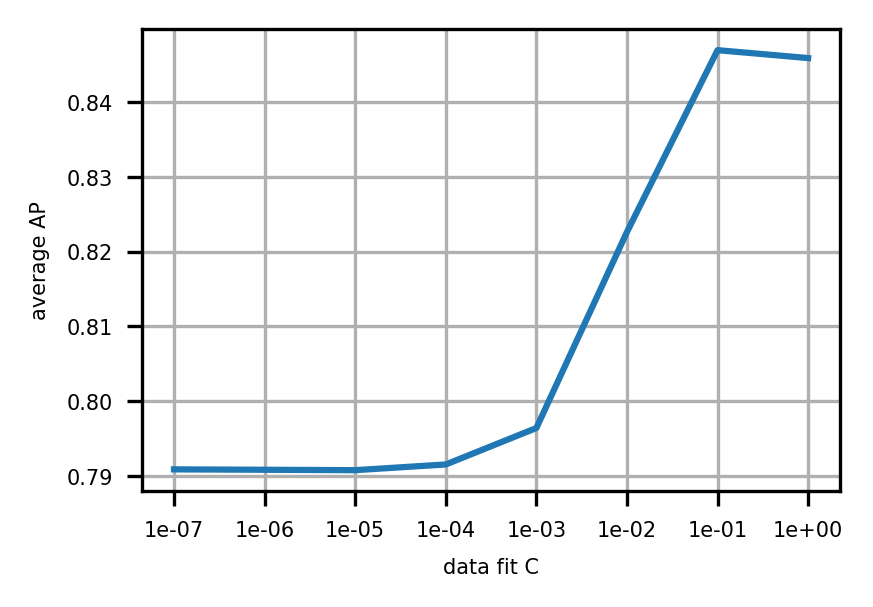

In [47]:
plt.figure(figsize=(3, 2), dpi=300)
plt.rcParams.update({
    "xtick.labelsize": 5,
    "ytick.labelsize": 5,
    "axes.labelsize": 5,
})

print(c)
plt.plot(scores.mean(axis=0))
plt.xticks(np.arange(len(cs)), ["{:.0e}".format(c) for c in cs])
plt.xlabel('data fit C')
plt.ylabel('average AP')
plt.grid()
plt.show()

### Retraining with the optimal regularization
Given the above, we seem to have a winner: C=0.1. 
Let's now train a model using this optimal data-fit value. 

In [48]:
print(xs.shape)
print(ys.shape)


torch.Size([21669, 384])
torch.Size([21669])


In [49]:
clf = LogisticRegression(random_state=0, C=0.1, max_iter=100000, verbose=2).fit(xs.numpy(), (ys > 0).long().numpy())

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s finished


### Test Images and Inference 

We have a classifier, now it is time to test it! We will predict the probability of patch being foreground given an image, and then process it with a 3x3 median filter to smooth it out.

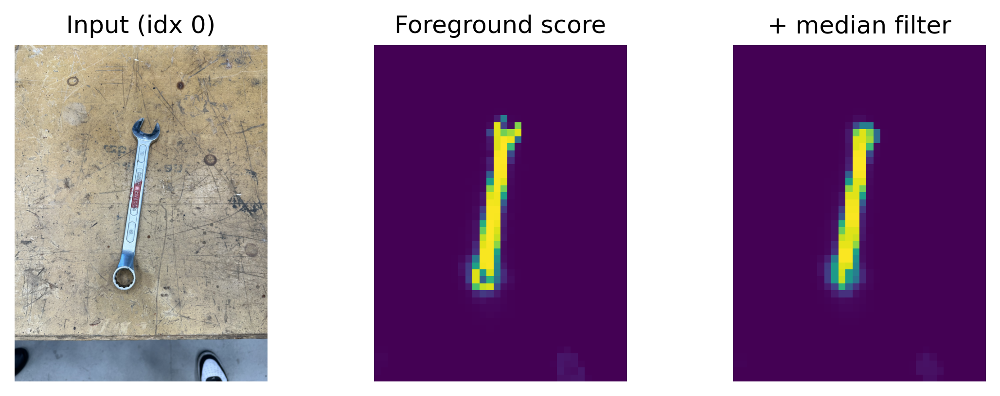

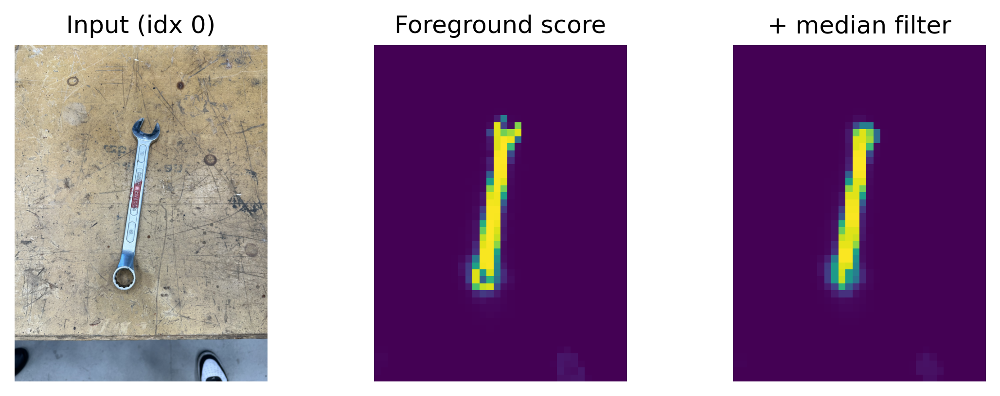

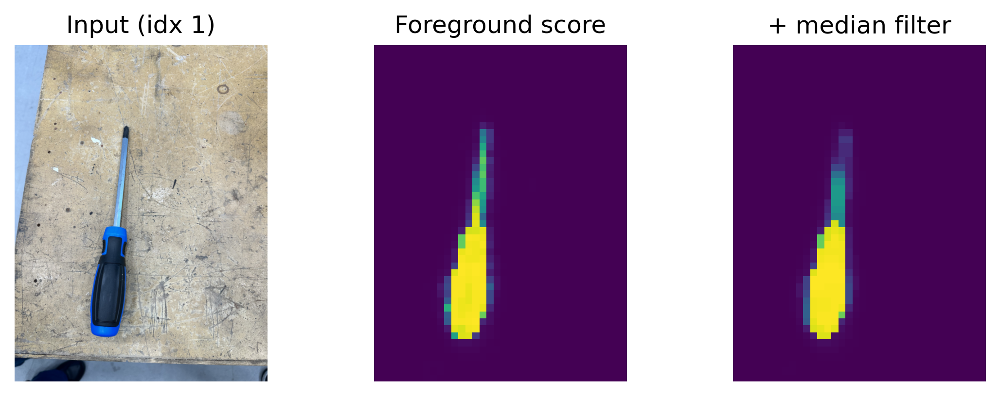

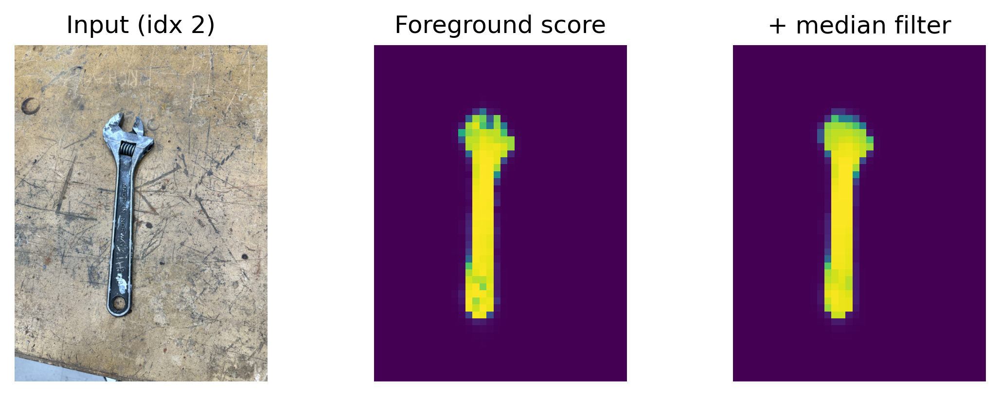

In [52]:
from contextlib import nullcontext
import matplotlib.pyplot as plt
import torch
import numpy as np
from PIL import Image

# Bruk CPU hvis du ikke har CUDA
device = "cuda" if torch.cuda.is_available() else "cpu"
amp_ctx = torch.autocast(device_type="cuda", dtype=torch.float16) if device == "cuda" else nullcontext()

def segment_and_show(pil_image: Image.Image, title=""):
    # 1) Preprocess (samme som i treningen)
    img = pil_image.convert("RGB")
    img_resized = resize_transform(img)  # (3, H, W) tensor
    img_norm = TF.normalize(img_resized, mean=IMAGENET_MEAN, std=IMAGENET_STD)

    # 2) Hent features fra siste lag
    with torch.inference_mode():
        with amp_ctx:
            feats = model.get_intermediate_layers(
                img_norm.unsqueeze(0).to(device),
                n=range(n_layers),
                reshape=True,
                norm=True
            )
            x = feats[-1].squeeze().detach().cpu()           # (D, Hpatch, Wpatch)
            dim = x.shape[0]
            x = x.view(dim, -1).permute(1, 0)                # (Npatches, D)

    # 3) Forutsi foreground-score med DIN logistiske regresjon (clf må være trent)
    h_patches, w_patches = [int(d / PATCH_SIZE) for d in img_resized.shape[1:]]
    fg_score = clf.predict_proba(x)[:, 1].reshape(h_patches, w_patches)

    # 4) (valgfritt) litt etterbehandling
    from scipy import signal
    fg_score_mf = torch.from_numpy(signal.medfilt2d(fg_score, kernel_size=3))

    # 5) Vis
    plt.figure(figsize=(9, 3), dpi=300)
    plt.subplot(1, 3, 1); plt.axis('off'); plt.imshow(img_resized.permute(1, 2, 0)); plt.title(f'Input {title}')
    plt.subplot(1, 3, 2); plt.axis('off'); plt.imshow(fg_score);                       plt.title('Foreground score')
    plt.subplot(1, 3, 3); plt.axis('off'); plt.imshow(fg_score_mf);                    plt.title('+ median filter')
    plt.show()

# --- KJØR PÅ DINE BILDER ---
# Ett bestemt bilde (f.eks. første):
segment_and_show(images[0], title="(idx 0)")

# Eller flere:
for idx in range(min(3, len(images))):
    segment_and_show(images[idx], title=f"(idx {idx})")



In [53]:
%pip install opencv-python

Note: you may need to restart the kernel to use updated packages.


In [64]:
import os
import urllib.request
import cv2
import numpy as np
import torch
import torchvision.transforms.functional as TF
from scipy import signal
from PIL import Image
from contextlib import nullcontext


def show_video_with_foreground_mask(
    video_path=None,
    model=None, clf=None, resize_transform=None,
    IMAGENET_MEAN=None, IMAGENET_STD=None,
    PATCH_SIZE=16, n_layers=12,
    apply_median_filter=True, show_original=True,
    fps_limit=30, window_size=(1200, 600)
):
    """
    Viser video med sanntids segmentering (DINOv3 + classifier)
    """

    # === 1️⃣ Opprett videomappe hvis den ikke finnes ===
    default_video_folder = r"C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Videoer"
    os.makedirs(default_video_folder, exist_ok=True)

    # === 2️⃣ Hvis ingen video er spesifisert, prøv å finne en ===
    if video_path is None:
        mp4_files = [f for f in os.listdir(default_video_folder) if f.lower().endswith(".mp4")]

        if not mp4_files:
            print("⚠️ Ingen MP4-videoer funnet – laster ned testvideo automatisk ...")
            test_url = "https://samplelib.com/lib/preview/mp4/sample-5s.mp4"
            test_path = os.path.join(default_video_folder, "test.mp4")
            urllib.request.urlretrieve(test_url, test_path)
            print(f"✅ Testvideo lastet ned: {test_path}")
            video_path = test_path
        else:
            video_path = os.path.join(default_video_folder, mp4_files[0])
            print(f"📹 Bruker video: {video_path}")

    # === 3️⃣ Sjekk at filen eksisterer ===
    if not os.path.exists(video_path):
        print(f"❌ Error: Video path does not exist: {video_path}")
        return

    # === 4️⃣ Device (CPU eller GPU) ===
    device = "cuda" if torch.cuda.is_available() else "cpu"
    amp_ctx = torch.autocast(device_type="cuda", dtype=torch.float16) if device == "cuda" else nullcontext()

    # === 5️⃣ Prosesser én frame ===
    def process_frame_for_segmentation(frame):
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame_pil = Image.fromarray(frame_rgb)

        frame_resized = resize_transform(frame_pil)
        frame_normalized = TF.normalize(frame_resized, mean=IMAGENET_MEAN, std=IMAGENET_STD)

        with torch.inference_mode():
            with amp_ctx:
                feats = model.get_intermediate_layers(
                    frame_normalized.unsqueeze(0).to(device),
                    n=range(n_layers), reshape=True, norm=True
                )
                x = feats[-1].squeeze().detach().cpu()
                dim = x.shape[0]
                x = x.view(dim, -1).permute(1, 0)

        h_patches, w_patches = [int(d / PATCH_SIZE) for d in frame_resized.shape[1:]]
        fg_score = clf.predict_proba(x)[:, 1].reshape(h_patches, w_patches)

        if apply_median_filter:
            fg_score = signal.medfilt2d(fg_score, kernel_size=3)

        return fg_score, frame_resized

    # === 6️⃣ Åpne video ===
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print(f"❌ Error: Could not open video {video_path}")
        return

    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) or 0
    original_fps = cap.get(cv2.CAP_PROP_FPS)
    if not original_fps or original_fps <= 0:
        original_fps = fps_limit

    print(f"🎞️ Video: {total_frames} frames at {original_fps:.1f} FPS")
    print("🎮 Controls: 'q' = quit, 'space' = pause/resume, 's' = save frame")

    frame_delay = max(1, int(1000 / min(fps_limit, original_fps)))
    paused = False
    frame_count = 0

    # === 7️⃣ Hovedløkke (videoavspilling) ===
    while True:
        if not paused:
            ret, frame = cap.read()
            if not ret:
                print("✅ End of video reached")
                break
            frame_count += 1

        try:
            fg_score, frame_resized = process_frame_for_segmentation(frame)

            frame_np = (frame_resized.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
            fg_score_norm = (fg_score * 255).astype(np.uint8)
            mask_colored = cv2.applyColorMap(fg_score_norm, cv2.COLORMAP_HOT)

            H, W = frame_np.shape[:2]
            mask_resized = cv2.resize(mask_colored, (W, H))

            if show_original:
                frame_bgr = cv2.cvtColor(frame_np, cv2.COLOR_RGB2BGR)
                combined = np.hstack([frame_bgr, mask_resized])
                cv2.putText(combined, f"Frame: {frame_count}/{total_frames}",
                            (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255,255,255), 2)
                display_frame = combined
            else:
                display_frame = mask_resized

            h, w = display_frame.shape[:2]
            if w > window_size[0] or h > window_size[1]:
                scale = min(window_size[0]/w, window_size[1]/h)
                display_frame = cv2.resize(display_frame, (int(w*scale), int(h*scale)))

            cv2.imshow("Foreground Segmentation", display_frame)

        except Exception as e:
            print(f"⚠️ Error processing frame {frame_count}: {e}")
            continue

        # === 8️⃣ Tastkontroller ===
        key = cv2.waitKey(frame_delay) & 0xFF
        if key == ord('q'):
            print("👋 Avslutter...")
            break
        elif key == ord(' '):
            paused = not paused
            print("⏸️ Pause" if paused else "▶️ Fortsetter")
        elif key == ord('s'):
            filename = os.path.join(default_video_folder, f"frame_{frame_count:06d}_seg.png")
            cv2.imwrite(filename, display_frame)
            print(f"💾 Lagret: {filename}")

    cap.release()
    cv2.destroyAllWindows()
    print("🏁 Video visning ferdig")




In [65]:
show_video_with_foreground_mask(
    model=model,
    clf=clf,
    resize_transform=resize_transform,
    IMAGENET_MEAN=IMAGENET_MEAN,
    IMAGENET_STD=IMAGENET_STD,
    PATCH_SIZE=PATCH_SIZE,
    n_layers=n_layers
)


⚠️ Ingen MP4-videoer funnet – laster ned testvideo automatisk ...
✅ Testvideo lastet ned: C:\Users\Ahmad\OneDrive\Skrivebord\Segmentering\Videoer\test.mp4
🎞️ Video: 171 frames at 30.0 FPS
🎮 Controls: 'q' = quit, 'space' = pause/resume, 's' = save frame


KeyboardInterrupt: 

### Saving the Model for Future Use
We are nearly done, let's just save a pickle with the classifier.


In [66]:
save_root = '.'
model_path = os.path.join(save_root, "fg_classifier.pkl")
with open(model_path, "wb") as f:
  pickle.dump(clf, f)